# Housing Price Prediction
### (using LinearRegression Model)
#### - HARSH YADAV

### IMPORTING  LIBRARIES & DATASET

In [1]:
import pandas as pd               # to import dataset and create data frames
import numpy as np                # for solving complex mathematical problems
import matplotlib.pyplot as plt   # tool for data visualization & representation
import seaborn as sns # based on matplotlib, but with more colourful themes
import sklearn


import statsmodels.api as smapi      
from sklearn.linear_model import LinearRegression
# NOTE: we can use any of the above library for linear regression model,
#       but i am using scikit_learn because its best for big data (no. of observations > 1000)

In [2]:
data = pd.read_csv(r"C:\Users\anika\OneDrive\Desktop\data_science\Housing Price Prediction.csv")

In [3]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,9106000005,5/27/2015,1310000.0,4,2.25,3750,5000,2.0,0,0,...,8,2440,1310,1924,0,98115,47.6747,-122.303,2170,4590
1,5101400871,5/24/2015,445500.0,2,1.75,1390,6670,1.0,0,0,...,6,720,670,1941,0,98115,47.6914,-122.308,920,6380
2,7923600250,5/15/2015,450000.0,5,2.00,1870,7344,1.5,0,0,...,7,1870,0,1960,0,98007,47.5951,-122.144,1870,7650
3,8730000270,5/14/2015,359000.0,2,2.75,1370,1140,2.0,0,0,...,8,1080,290,2009,0,98133,47.7052,-122.343,1370,1090
4,9178601660,5/14/2015,1700000.0,5,3.00,3320,5354,2.0,0,0,...,9,3320,0,2004,0,98103,47.6542,-122.331,2330,4040


In [4]:
data.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,0.007547,0.234292,3.409825,7.657915,1788.596842,291.725008,1970.999676,84.464787,98077.951845,47.560093,-122.213982,1986.620318,12758.283512
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,0.086549,0.766390,0.650546,1.173200,827.759761,442.667800,29.375234,401.821438,53.513072,0.138552,0.140724,685.230472,27274.441950
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,3.000000,370.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     21597 non-null  int64  
 9   view           21597 non-null  int64  
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  int64  
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   21597 non-null  int64  
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [6]:
data.corr() # TO GET CORELLATION BETWEEN EVERY FEATURE OF DATASET

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016772,0.001150,0.005162,-0.012241,-0.131911,0.018608,-0.002727,0.011536,-0.023803,0.008188,-0.010799,-0.005193,0.021617,-0.016925,-0.008211,-0.001798,0.020672,-0.002701,-0.138557
price,-0.016772,1.000000,0.308787,0.525906,0.701917,0.089876,0.256804,0.266398,0.397370,0.036056,0.667951,0.605368,0.323799,0.053953,0.126424,-0.053402,0.306692,0.022036,0.585241,0.082845
bedrooms,0.001150,0.308787,1.000000,0.514508,0.578212,0.032471,0.177944,-0.006834,0.080008,0.026496,0.356563,0.479386,0.302808,0.155670,0.018389,-0.154092,-0.009951,0.132054,0.393406,0.030690
bathrooms,0.005162,0.525906,0.514508,1.000000,0.755758,0.088373,0.502582,0.063744,0.188386,-0.126479,0.665838,0.686668,0.283440,0.507173,0.050544,-0.204786,0.024280,0.224903,0.569884,0.088303
sqft_living,-0.012241,0.701917,0.578212,0.755758,1.000000,0.173453,0.353953,0.103854,0.284709,-0.059445,0.762779,0.876448,0.435130,0.318152,0.055308,-0.199802,0.052155,0.241214,0.756402,0.184342
sqft_lot,-0.131911,0.089876,0.032471,0.088373,0.173453,1.000000,-0.004814,0.021632,0.074900,-0.008830,0.114731,0.184139,0.015418,0.052946,0.007686,-0.129586,-0.085514,0.230227,0.144763,0.718204
floors,0.018608,0.256804,0.177944,0.502582,0.353953,-0.004814,1.000000,0.023755,0.028814,-0.264075,0.458794,0.523989,-0.245715,0.489193,0.006427,-0.059541,0.049239,0.125943,0.280102,-0.010722
waterfront,-0.002727,0.266398,-0.006834,0.063744,0.103854,0.021632,0.023755,1.000000,0.401971,0.016611,0.082888,0.072109,0.080559,-0.026153,0.092873,0.030272,-0.014306,-0.041904,0.086507,0.030781
view,0.011536,0.397370,0.080008,0.188386,0.284709,0.074900,0.028814,0.401971,1.000000,0.045999,0.251728,0.167609,0.277078,-0.053636,0.103951,0.084622,0.005871,-0.078107,0.280681,0.072904
condition,-0.023803,0.036056,0.026496,-0.126479,-0.059445,-0.008830,-0.264075,0.016611,0.045999,1.000000,-0.146896,-0.158904,0.173849,-0.361592,-0.060788,0.002888,-0.015102,-0.105877,-0.093072,-0.003126


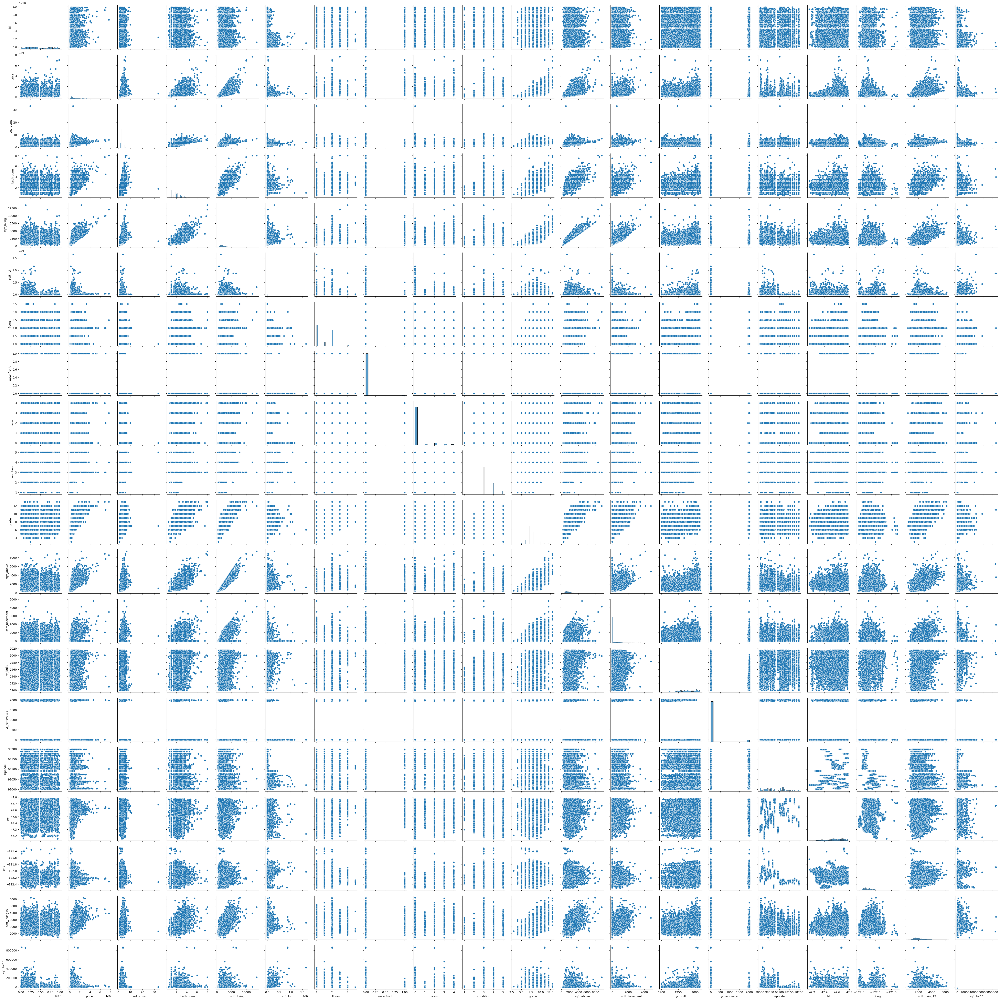

In [92]:
sns.pairplot(data)

### checking for missing_values


In [8]:
data.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [9]:
#no null values are there

In [10]:
#No need to create dummy variables
#just we have to deal with "date" as it is of data_type = "object"
#there are a lot ways to perform with "High Cardinallity Variables" like "Date"
#we can:_
#1) - Embed with Freq
#2) - Target Encoding
#3) - or Simply Drop
# I am using 3rd technique here,

In [11]:
data.dtypes

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

Dropping the date variable, because of its "High Cardinallity"

In [12]:
data = data.drop(['date'],axis = 1)

In [13]:
data.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,9106000005,1310000.0,4,2.25,3750,5000,2.0,0,0,5,8,2440,1310,1924,0,98115,47.6747,-122.303,2170,4590
1,5101400871,445500.0,2,1.75,1390,6670,1.0,0,0,3,6,720,670,1941,0,98115,47.6914,-122.308,920,6380
2,7923600250,450000.0,5,2.00,1870,7344,1.5,0,0,3,7,1870,0,1960,0,98007,47.5951,-122.144,1870,7650
3,8730000270,359000.0,2,2.75,1370,1140,2.0,0,0,3,8,1080,290,2009,0,98133,47.7052,-122.343,1370,1090
4,9178601660,1700000.0,5,3.00,3320,5354,2.0,0,0,3,9,3320,0,2004,0,98103,47.6542,-122.331,2330,4040


##### Removing targetted value"Price" from whole dataset"data

In [14]:
y = data.loc[:,"price"]
X = data.drop("price", axis = 1)

In [15]:
X.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,9106000005,4,2.25,3750,5000,2.0,0,0,5,8,2440,1310,1924,0,98115,47.6747,-122.303,2170,4590
1,5101400871,2,1.75,1390,6670,1.0,0,0,3,6,720,670,1941,0,98115,47.6914,-122.308,920,6380
2,7923600250,5,2.00,1870,7344,1.5,0,0,3,7,1870,0,1960,0,98007,47.5951,-122.144,1870,7650
3,8730000270,2,2.75,1370,1140,2.0,0,0,3,8,1080,290,2009,0,98133,47.7052,-122.343,1370,1090
4,9178601660,5,3.00,3320,5354,2.0,0,0,3,9,3320,0,2004,0,98103,47.6542,-122.331,2330,4040


<AxesSubplot:>

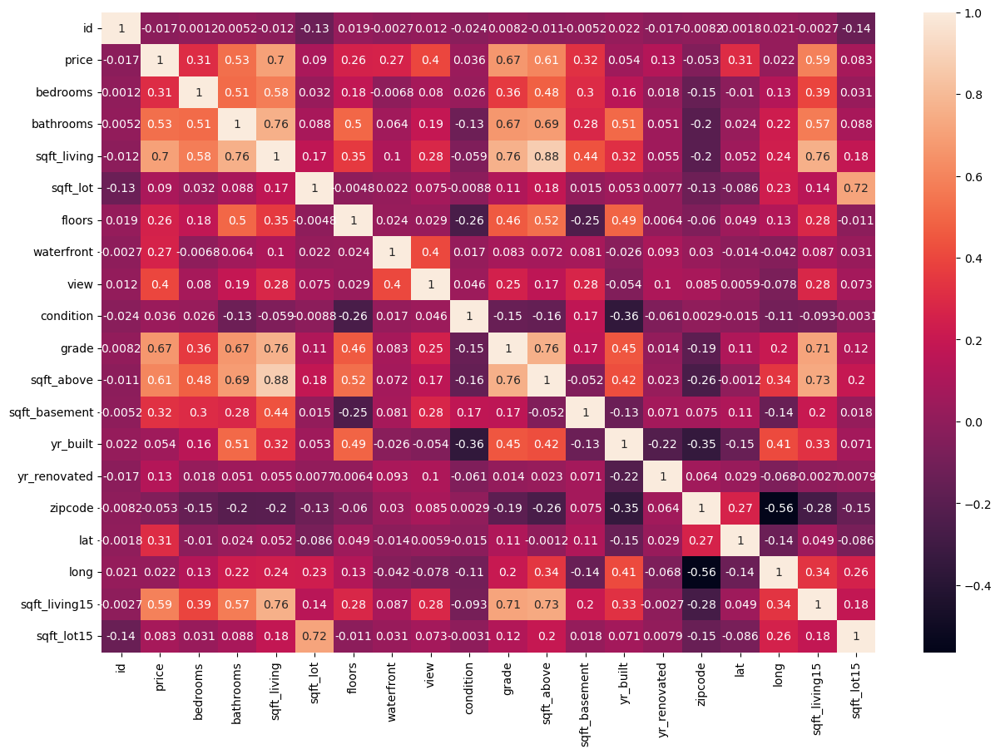

In [17]:
plt.figure(figsize = (15,10))
sns.heatmap(data.corr(), annot = True)
# HEATMAP SHOWS US THE COLLINEARITY BY VISUALISATION & COLOUR GRADING
# WHICH MAKES IT REALLY EASY TO UNDERSTAND THE RELATION BETWEEN 2 VARIABLES
# HERE, LIGHT COLOURS ARE DEPICTING GREATER CORRELATION VALUE
# & DARK COLOURS ARE DEPICTING LESSER COORELATION VALUE

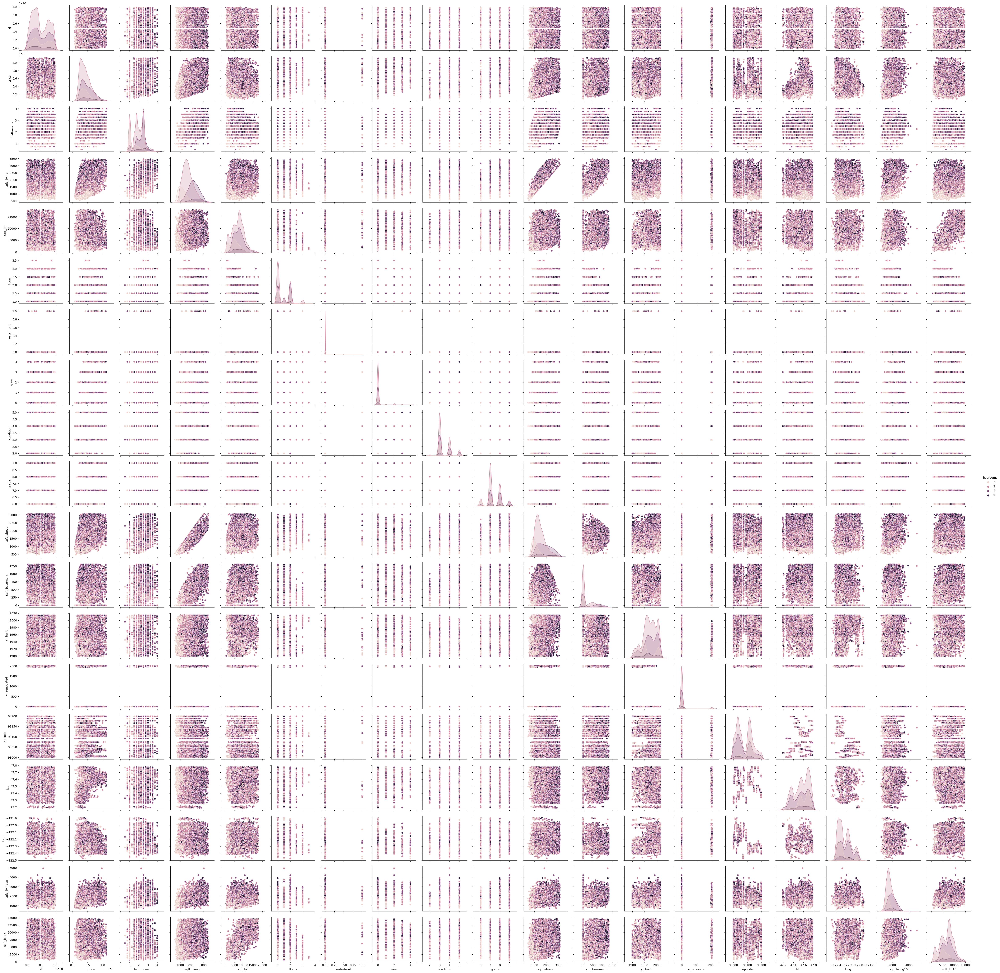

In [89]:
#by using 'hue' in pairplot, we can see how no. of bedrooms are corellated with other features of dataset
#we can see the prices are low for light-colored dots, that means
#dark ones are bhks like 33,10 & 
#light ones are bhk's like 2,3..
sns.pairplot(df, hue = 'bed,rooms')
plt.savefig("hue")

In [90]:
# PANDAS PROFILING REPORT WILL GIVE US THE DETAILED INFO ABOUT OUR DATA
# THIS WILL HELP US UNDERSTAND OUR DATA, FEATURES, RECORDS, CORRELATIONS, MIN, MAX, COUNT AND A LOT MORE...
from pandas_profiling import ProfileReport
profile = ProfileReport(data, title="Pandas Profiling Report")

In [91]:
profile.to_file("your_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

##### Splitting X into :- Test & Split 

In [16]:
from sklearn.model_selection import train_test_split
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size = 0.2, random_state = 2)

##### Implementing Linear Regression 

In [17]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(train_X, train_y)


LinearRegression()

##### Predicting Results

In [18]:
y_pred = lin_reg.predict(test_X)

In [19]:
y_pred

array([287427.00051628, 453058.91054017, 476005.88972716, ...,
       235061.9013533 , 491208.01432038, 396778.71761236])

## Calculating MAPE(Mean Absolute Percentage Error)

In [20]:
from sklearn.metrics import mean_absolute_percentage_error
mean_absolute_percentage_error(test_y, y_pred)*100

25.102180232553984

In [21]:
# Pretty Good Scores....That means Our MAPE is 25.10 %
# or we can say that our predicted values are "25.10 % deviated" from our Actual Results

In [22]:
# we can easily calculate Accuracy of our Linear Regression Model By Subtracting (100-MAPE)%

In [23]:
100 - 25.10

74.9

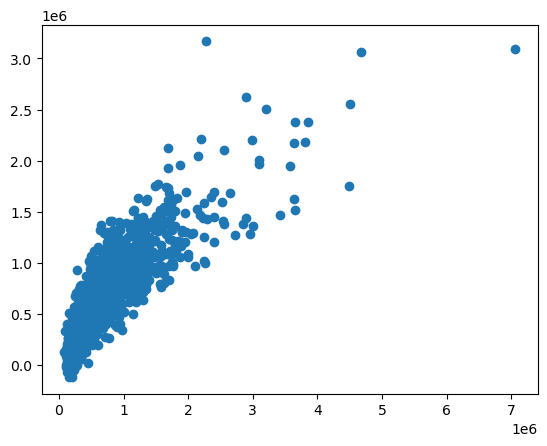

In [24]:
plt.scatter(test_y, y_pred)

## We Have Got 74.9% of Accuracy 
#### (Using Scikit Learn Library & With Outliers)

# Now Doing it after removing Outliers

In [25]:
# we will first create a copy of our dataset-"data", and create a dataFrame-"df"

In [26]:
df = data.copy()

In [27]:
df.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,9106000005,1310000.0,4,2.25,3750,5000,2.0,0,0,5,8,2440,1310,1924,0,98115,47.6747,-122.303,2170,4590
1,5101400871,445500.0,2,1.75,1390,6670,1.0,0,0,3,6,720,670,1941,0,98115,47.6914,-122.308,920,6380
2,7923600250,450000.0,5,2.00,1870,7344,1.5,0,0,3,7,1870,0,1960,0,98007,47.5951,-122.144,1870,7650
3,8730000270,359000.0,2,2.75,1370,1140,2.0,0,0,3,8,1080,290,2009,0,98133,47.7052,-122.343,1370,1090
4,9178601660,1700000.0,5,3.00,3320,5354,2.0,0,0,3,9,3320,0,2004,0,98103,47.6542,-122.331,2330,4040


<AxesSubplot:>

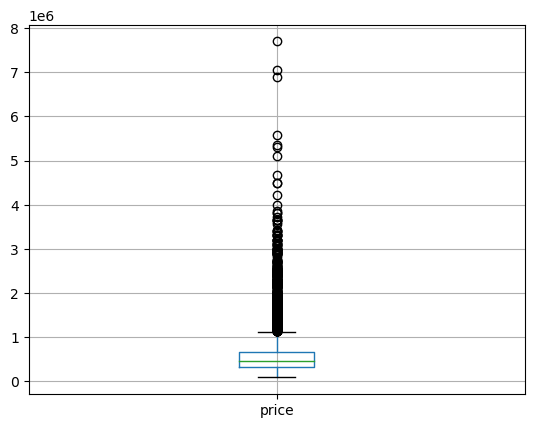

In [28]:
#we know that to find Outliers, Boxplot is Best Visualization plot
df.boxplot(column = ['price'])

In [29]:
#there is a significant amount of outliers...so we have to treat them

### Function to Treat Outliers

In [30]:
def OutRem (data, Var_name):
    Q1 = data[Var_name].quantile(0.25)  #first Quartile
    Q3 = data[Var_name].quantile(0.75)  #third Quartile
    IQR = Q3 - Q1                       #Calculating Inter-Quantile Range
    data = data.loc[~((data[Var_name] < (Q1 - 1.5 * IQR)) | (data[Var_name] > (Q3 + 1.5 * IQR))),]
    return data

In [31]:
# Treating price's Outliers
df = OutRem(df,"price")

In [32]:
%matplotlib inline

<AxesSubplot:>

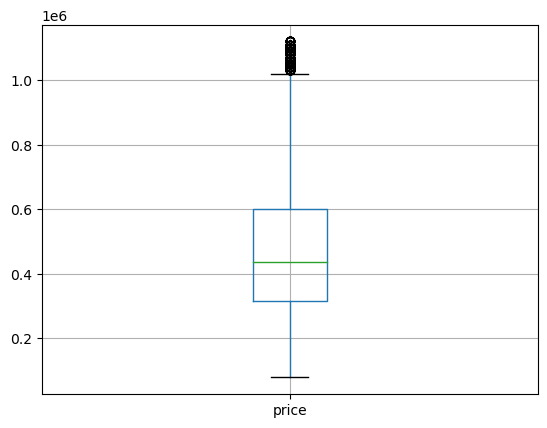

In [33]:
#Again checking to Confirm that Outliers have been treated.
df.boxplot(column = ['price']) 

In [34]:
# we can see the change clearly, outliers have been treated to an extent.
# we can ignore that small outliers still showing

In [35]:
# Treating id's Outliers
df = OutRem(df,"id") 

<AxesSubplot:>

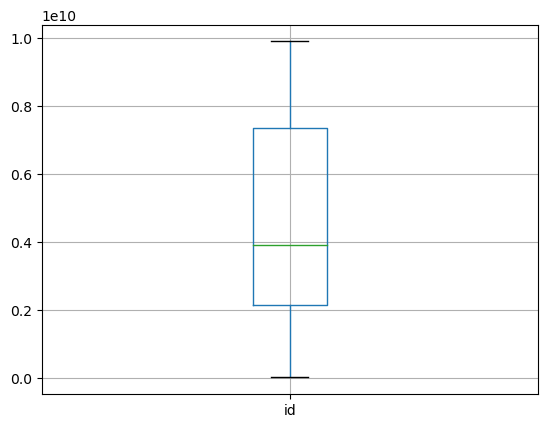

In [36]:
df.boxplot(column = ['id'])

<AxesSubplot:>

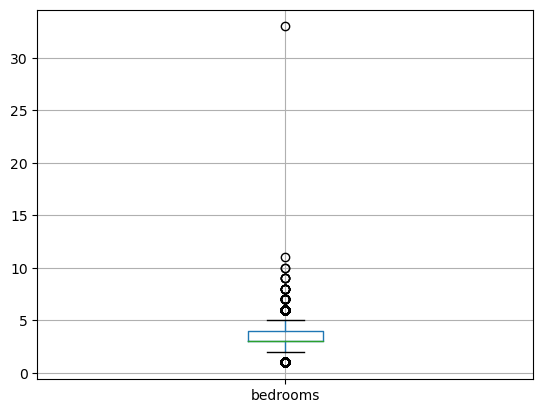

In [37]:
df.boxplot(column = ['bedrooms'])

In [38]:
# Treating bedrooms's Outliers
df = OutRem(df,"bedrooms")

<AxesSubplot:>

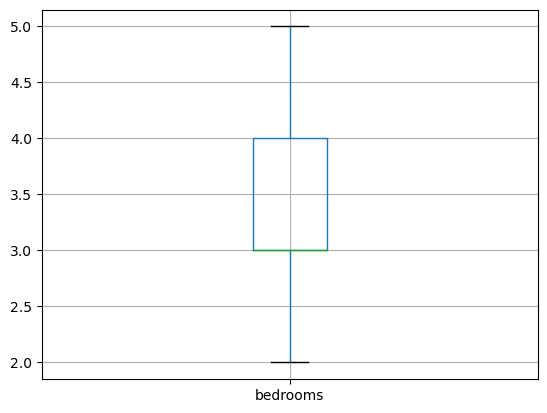

In [39]:
df.boxplot(column = ['bedrooms'])

<AxesSubplot:>

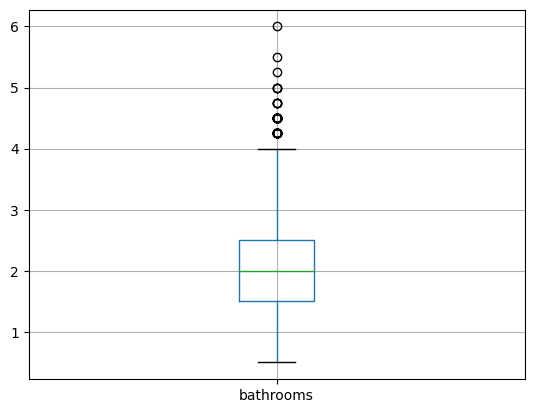

In [40]:
df.boxplot(column = ['bathrooms'])

In [41]:
# Treating bathrooms's Outliers
df = OutRem(df,"bathrooms")

<AxesSubplot:>

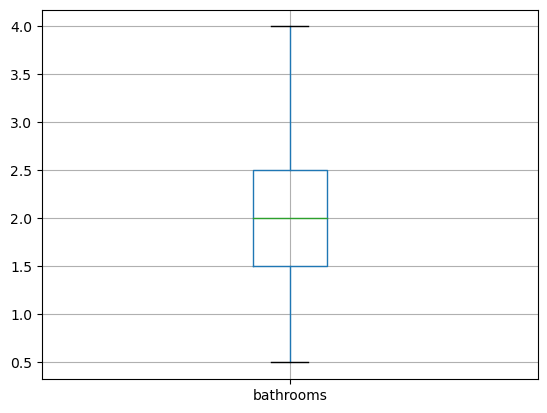

In [42]:
df.boxplot(column = ['bathrooms'])

<AxesSubplot:>

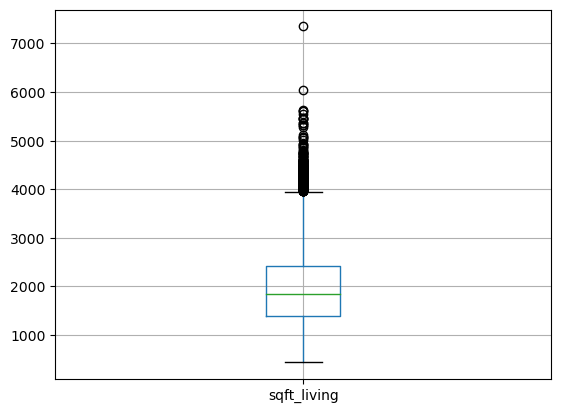

In [43]:
df.boxplot(column = ['sqft_living'])

In [44]:
# Treating sqft_living's Outliers
df = OutRem(df,"sqft_living")

<AxesSubplot:>

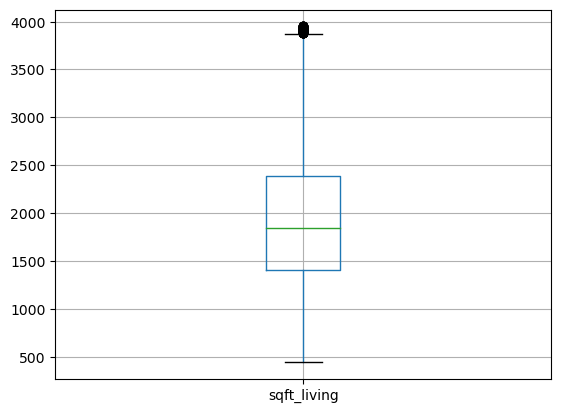

In [45]:
df.boxplot(column = ['sqft_living'])

In [46]:
df = OutRem(df,"sqft_lot")

In [47]:
df = OutRem(df,"floors")

In [48]:
df = OutRem(df,"condition")

In [49]:
df = OutRem(df,"grade")

In [50]:
df = OutRem(df,"sqft_above")

In [51]:
df = OutRem(df,"sqft_basement")

In [52]:
df = OutRem(df,"yr_built")

In [53]:
df = OutRem(df,"zipcode")
df = OutRem(df,"lat")
df = OutRem(df,"long")
df = OutRem(df,"sqft_living")
df = OutRem(df,"sqft_lot15")
# I have not Included certain Variables here, because they were type of binary, like waterfront,view etc.

In [54]:
# again doing same steps, as we did with dataset-"data"
y = df.loc[:,"price"]
X = df.drop("price", axis = 1)

In [55]:
#SPlitting train & test data
from sklearn.model_selection import train_test_split
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size = 0.2, random_state = 2)

In [56]:
# Again Linear Regression
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(train_X, train_y)

LinearRegression()

In [57]:
y_pred_wo = lin_reg.predict(test_X)

In [58]:
len(y_pred_wo)

3092

In [59]:
len(test_y)

3092

## MAPE(Without Outliers)

In [60]:
mean_absolute_percentage_error(test_y, y_pred_wo)*100

19.781135275315087

In [61]:
# we have improvised the model by removing the outliers and by making it more balanced

In [62]:
100 - 19.78

80.22

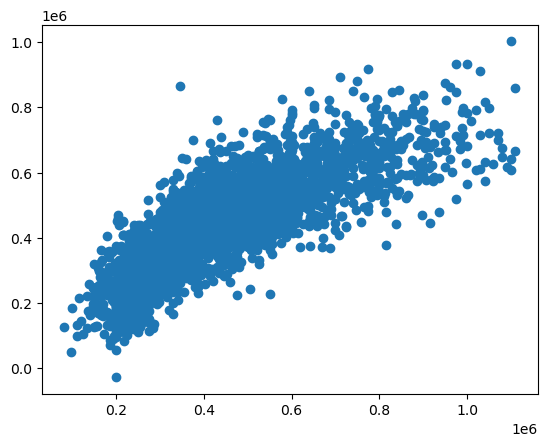

In [63]:
plt.scatter(test_y, y_pred_wo)

## WE HAVE FINALLY ACHIEVED AN ACCURACY OF "80.22%" BY REMOVING OUTLIERS FROM SOME VARIABLES

# Decision Tree Regression

In [64]:
from sklearn.tree import DecisionTreeRegressor

In [65]:
dt = DecisionTreeRegressor(random_state = 2)
dt.fit(train_X, train_y)

DecisionTreeRegressor(random_state=2)

In [66]:
y_pred_dt = dt.predict(test_X)

In [67]:
mean_absolute_percentage_error(test_y, y_pred_dt)

0.16507669880726836

In [68]:
100-16.50

83.5

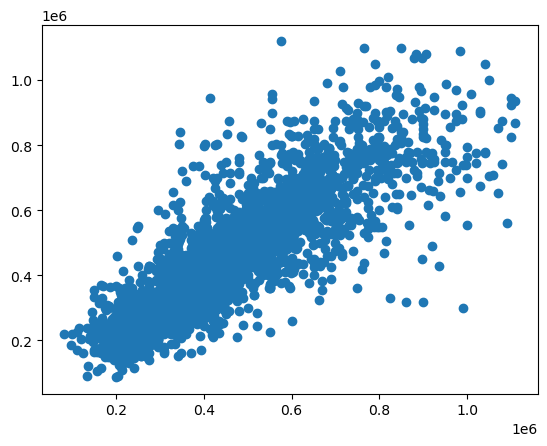

In [69]:
plt.scatter(test_y, y_pred_dt)

# RANDOM FOREST REGRESSOR

In [70]:
from sklearn.ensemble import RandomForestRegressor

In [71]:
rf = RandomForestRegressor(n_estimators = 1000, random_state = 2)
rf.fit(train_X, train_y)

RandomForestRegressor(n_estimators=1000, random_state=2)

In [72]:
y_pred_rf = rf.predict(test_X)

In [73]:
mean_absolute_percentage_error(test_y, y_pred_rf)

0.11566496080803386

In [74]:
100-11.56

88.44

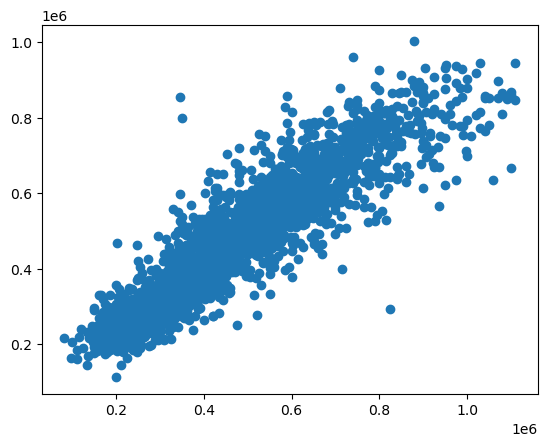

In [75]:
plt.scatter(test_y, y_pred_rf)

# XGboost

In [86]:
!pip install xgboost

In [87]:
import xgboost as xg

In [88]:
xgb_r = xg.XGBRFRegressor()
xgb_r.fit(train_X, train_y)

XGBRFRegressor(base_score=0.5, booster='gbtree', callbacks=None,
               colsample_bylevel=1, colsample_bytree=1,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
               grow_policy='depthwise', importance_type=None,
               interaction_constraints='', max_bin=256, max_cat_threshold=64,
               max_cat_to_onehot=4, max_delta_step=0, max_depth=6, max_leaves=0,
               min_child_weight=1, missing=nan, monotone_constraints='()',
               n_estimators=100, n_jobs=0, num_parallel_tree=100,
               objective='reg:squarederror', predictor='auto', random_state=0,
               reg_alpha=0, ...)

In [89]:
y_pred_x = xgb_r.predict(test_X)

In [90]:
mean_absolute_percentage_error(test_y, y_pred_x)

0.14498487241580113

In [91]:
100-14.49

85.51

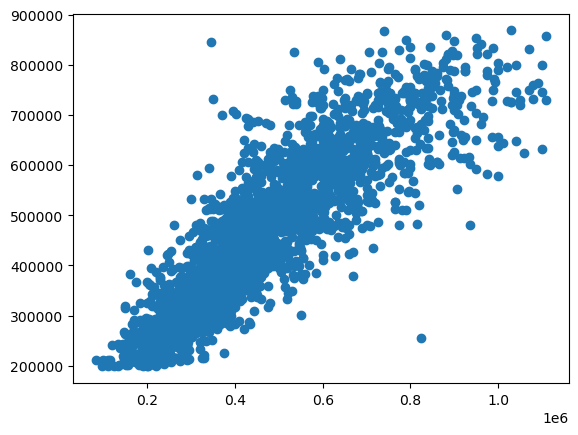

In [92]:
plt.scatter(test_y, y_pred_x)


# GRADIENT BOOSTING REGRESSION


In [77]:
from sklearn.ensemble import GradientBoostingRegressor
clf = GradientBoostingRegressor(n_estimators = 400, max_depth = 5, min_samples_split = 2, learning_rate = 0.1, loss = 'squared_error')

#### n_estimator — The number of boosting stages to perform. We should not set it too high which would                                       overfit our model
#### max_depth — The depth of the tree node  
#### learning_rate — Rate of learning the data
#### loss — loss function 
#### minimum sample split — Number of sample to be split for learning the data

In [78]:
clf.fit(train_X, train_y)

GradientBoostingRegressor(max_depth=5, n_estimators=400)

In [79]:
y_pred_clf = clf.predict(test_X)

In [80]:
mean_absolute_percentage_error(test_y, y_pred_clf)*100

10.99443490267817

In [81]:
#MAPE is 10.99
100-10.99

89.01

In [82]:
# point to be noted : the accuracy is between - ( test"y" & predicted"y" )

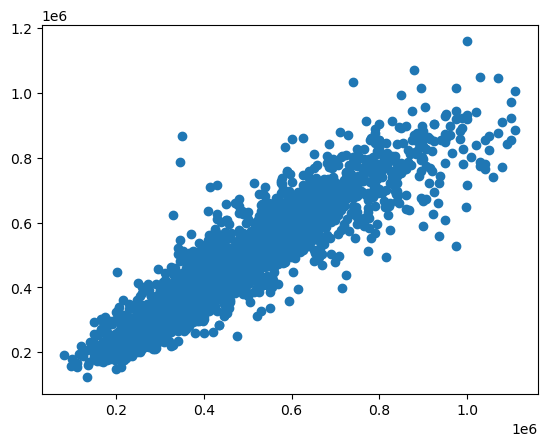

In [83]:
plt.scatter(test_y, y_pred_clf)

## We Have Achieved the Accuracy of "89.01%" by GRADIENT BOOSTING REGRESSION.


In [100]:
# model.score automates the prediction of the data using X_test and compares it with Y_test and by 
# default uses the R-squared metric to so (hence don't need to manually derive y_pred).
clf.score(test_X, test_y)

0.8659642506327195

In [103]:
#we can also check this using r2_score
sklearn.metrics.r2_score(test_y, y_pred_clf)

0.8659642506327195

## CROSS-VALIDATION SCORES OF SOME MODELS

In [109]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score

In [110]:
# cv_score of "RandomForestRegressor"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
cross_val_score(RandomForestRegressor(), X, y, cv=cv)

array([0.85870483, 0.85035836, 0.85279999, 0.83998357, 0.8604371 ])

In [111]:
# cv_score of "GradientBoostingRegressor"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
cross_val_score(GradientBoostingRegressor(), X, y, cv=cv)

array([0.84148168, 0.83184076, 0.84058511, 0.82753675, 0.84442999])

C:\Users\anika\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


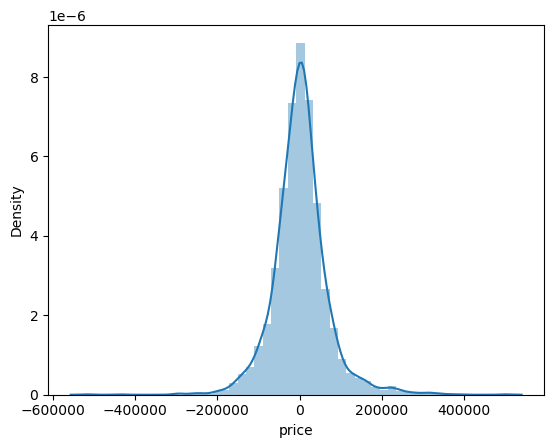

In [120]:
sns.distplot((test_y-y_pred_clf),bins=50);

In [126]:
len(df)


15458

ValueError: Length of ndarray vectors must match length of `data` when both are used, but `data` has length 15458 and the vector passed to `y` has length 3092.

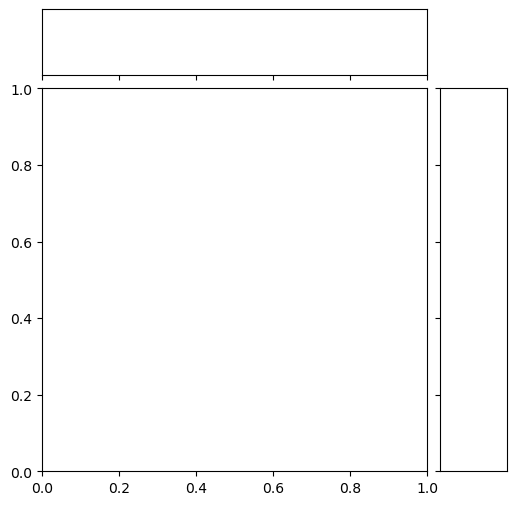

In [84]:
sns.jointplot(x = test_y, y = y_pred_clf, data = df, kind = 'hex')